# Beyond EVs: Electric Vehicles Data Analysis



We are performing an analysis of electric vehicles, specifically of what factors are associated with electric vehicle adoption, how we can model and forecast EV adoption towards the future, how existing electrical infrastructure needs to change to adapt to increased EV adoption rates, and how can we display our findings clearly.

Our project is comprised of four major parts:
- Exploratory data analysis of an electric vehicle population in a certain geographic area.
- Constructing a machine learning model that forecasts electric vehicle adoption in the area.
- Feeding the output of the forecasting model as an input to another model that determines the sustainability of electrical infrastructure given increased adoption of EVs.
- Creating a map that displays which areas of the geographic area is most susceptible to strain on their electrical infrastructure due to EVs.

---

## Load Data

Let us import the packages that we will need for our analysis here.

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Firstly, we must load data into our colab notebook. There are two ways to do this.
1. Add the dataset to Drive, and grant the notebook access to your Google Drive filesystem. In general, I believe that this is the preferred method to access datasets because it also stores the datasets into a shared remote datastore.
2. Upload the dataset directly to the notebook's local memory. The dataset gets cleared after the runtime resets (because this is only stored in local memory), so this is less preferred but can be useful for just testing datasets without uploading to Drive.

### Mount Google Drive Filesystem

In order access the Google Drive filesystem to access datasets stored on Drive:

1.   First, add your dataset into the `datasets` shared folder on Drive.
2.   Run the code block below, follow the link, and input the authorization code below. This will mount your local Drive filesystem and give this notebook access to those files.
3.   The filesystem will currently be mounted at `/content/gdrive`, so in order to get to your home directory in Google Drive, use the `global_path` variable which leads you to `/gdrive/My Drive`.
4.   Add your local path to where the dataset is stored. For example, Lawrence's path is `/Classwork/Data-X/project/datasets`, and store it into the `local_path` variable.
5.   Note that this we should only need to mount once per runtime.

In [3]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
global_path = 'gdrive/My Drive'
local_path = '/Classwork/Data-X/project/datasets'

In [0]:
ev_pop = pd.read_csv(global_path + local_path + "/Electric_Vehicle_Population_Data.csv")

In [6]:
ev_pop.head()

,VIN (1-10),County,City,State,ZIP Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location
0,1N4AZ1CP1J,King,Seattle,WA,98103,2018,Nissan,Leaf,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,151,29990.0,43.0,121175701,POINT (-122.343577 47.672491)
1,5YJSA4H22F,Pierce,Tacoma,WA,98409,2015,Tesla,Model S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,208,69900.0,29.0,271292283,NaN
2,1N4BZ0CP2H,Pierce,Tacoma,WA,98405,2017,Nissan,Leaf,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,107,30680.0,27.0,7605944,NaN
3,1N4BZ0CP8G,Clark,Vancouver,WA,98685,2016,Nissan,Leaf,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,84,29010.0,18.0,239048442,NaN
4,1FADP5CU1F,King,Tukwila,WA,98188,2015,Ford,C-MAX Energi,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,19,31770.0,11.0,134196814,POINT (-122.276826 47.449726)


### Upload Dataset to Notebook

Run the code block below, choose a csv file, and wait for it so upload. You can then read the csv as if it were a file in your current directory.

In [0]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

In [0]:
# df = pd.read_csv("Electric_Vehicle_Population_Data.csv")

---

## Exploratory Data Analysis

We will now explore our imported datasets to figure out what variables we will be including into our model.

### Analysis of Washington State EV Population 

In [0]:
# This dataset shows the Battery Electric Vehicles (BEVs) and Plug-in Hybrid Electric Vehicles (PHEVs) that are currently registered through Washington State Department of Licensing (DOL).
ev_pop.head()

,VIN (1-10),County,City,State,ZIP Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location
0,1N4AZ1CP1J,King,Seattle,WA,98103,2018,Nissan,Leaf,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,151,29990.0,43.0,121175701,POINT (-122.343577 47.672491)
1,5YJSA4H22F,Pierce,Tacoma,WA,98409,2015,Tesla,Model S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,208,69900.0,29.0,271292283,NaN
2,1N4BZ0CP2H,Pierce,Tacoma,WA,98405,2017,Nissan,Leaf,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,107,30680.0,27.0,7605944,NaN
3,1N4BZ0CP8G,Clark,Vancouver,WA,98685,2016,Nissan,Leaf,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,84,29010.0,18.0,239048442,NaN
4,1FADP5CU1F,King,Tukwila,WA,98188,2015,Ford,C-MAX Energi,Plug-in Hybrid Electric Vehicle (PHEV),Not eligible due to low battery range,19,31770.0,11.0,134196814,POINT (-122.276826 47.449726)


In [0]:
ev_pop.describe()

,ZIP Code,Model Year,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID
count,55421.000000,55421.000000,55421.000000,54938.000000,55301.000000,5.542100e+04
mean,98148.286624,2016.433716,126.285018,41106.355710,30.427551,2.391140e+08
std,2574.133945,2.197673,84.843965,17204.978865,14.639879,1.281276e+08
min,1731.000000,2002.000000,6.000000,22995.000000,1.000000,1.949000e+03
25%,98052.000000,2015.000000,47.000000,31635.000000,21.000000,1.480420e+08
50%,98117.000000,2017.000000,93.000000,35000.000000,35.000000,2.196631e+08
75%,98360.000000,2018.000000,215.000000,39145.000000,43.000000,3.180963e+08
max,99403.000000,2020.000000,289.000000,845000.000000,49.000000,4.792548e+08


In [0]:
ev_pop.shape

(55421, 15)

In [0]:
list(sorted(ev_pop['Model Year'].unique()))

[2002, 2008, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020]

In [0]:
# Y, variable to predict, adoption (rate) over different counties/cities/zipcodes in WA
ev_pop.groupby(['Model Year', 'County']).count()[['State']]

State
Model Year County          
2002       Clallam        1
           King           1
           San Diego      1
           Thurston       1
2008       King          14
...                     ...
2020       King          16
           Kitsap         1
           Skagit         1
           Snohomish      5
           Whatcom        1

[439 rows x 1 columns]

In [0]:
# Other possiblity for Y, overall adoption (rate) over entire state of WA
ev_pop.groupby('Model Year').count()[['State']]

,State
Model Year,
2002,4
2008,22
2010,31
2011,971
2012,1883
2013,5136
2014,3959
2015,5305
2016,6407


In [0]:
ev_pop.groupby('County').count()[['State']].sort_values('State', ascending=False).head(30)

,State
County,
King,30232
Snohomish,5795
Pierce,3991
Clark,2930
Thurston,2166
Kitsap,1913
Whatcom,1499
Spokane,1148
Island,660


### Analysis of Vehicle Registration in Washington State

In [0]:
# Data includes transactions completed January 2010 through February 2020; dataset from WA Department of Licensing
ev_reg = pd.read_csv(global_path + local_path + "/Electric_Vehicle_Title_and_Registration_Activity.csv")

In [8]:
ev_reg.head()

,Clean Alternative Fuel Vehicle Type,VIN (1-10),Model Year,Make,Model,New or Used Vehicle,Sale Price,DOL Transaction Date,Transaction Type,Transaction Year,Electric Vehicle Fee Paid,County,City,Zip,Electric Range,Base MSRP,2015 HB 2778 Exemption Eligibility,Sale Date,Vehicle Primary Use,State of Residence,DOL Vehicle ID,Legislative District,2019 HB 2042 Clean Alternative Fuel Vehicle (CAFV) Eligibility,Meets 2019 HB 2042 Electric Range Requirement,Meets 2019 HB 2042 Sale Date Requirement,Meets 2019 HB 2042 Sale Price/Value Requirement
0,Battery Electric Vehicle (BEV),5YJSA1E20J,2018,Tesla,Model S,Used,0,May 15 2019,Registration Renewal,2019,Yes,Clark,Camas,98607.0,249,74500.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,241150857,18.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
1,Battery Electric Vehicle (BEV),5YJSA1E20J,2018,Tesla,Model S,Used,0,September 13 2019,Registration Renewal,2019,Yes,King,Bothell,98011.0,249,74500.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,139598161,1.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
2,Battery Electric Vehicle (BEV),5YJSA1E18G,2016,Tesla,Model S,Used,0,November 30 2018,Registration Renewal,2018,Yes,Grant,Quincy,98848.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,348761374,13.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
3,Battery Electric Vehicle (BEV),5YJSA1E18G,2016,Tesla,Model S,New,0,February 03 2017,Original Registration,2017,No,King,Sammamish,98074.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,171877849,45.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
4,Battery Electric Vehicle (BEV),5YJSA1E18G,2016,Tesla,Model S,Used,0,December 26 2017,Registration Renewal,2017,Yes,King,Sammamish,98074.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,171877849,45.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False


In [0]:
ev_reg.describe()

,Model Year,Sale Price,Transaction Year,Zip,Electric Range,Base MSRP,DOL Vehicle ID,Legislative District
count,286879.000000,2.868790e+05,286879.000000,286869.000000,286879.000000,285838.000000,2.868790e+05,286050.000000
mean,2015.282063,7.256065e+03,2017.074938,98121.020354,106.564095,40379.699071,2.129106e+08,30.525555
std,2.309013,3.028829e+04,2.020866,2783.606606,77.424708,16805.022035,1.078491e+08,14.707837
min,1998.000000,0.000000e+00,2010.000000,1375.000000,0.000000,16995.000000,4.000000e+00,1.000000
25%,2013.000000,0.000000e+00,2016.000000,98043.000000,38.000000,29990.000000,1.423156e+08,21.000000
50%,2015.000000,0.000000e+00,2018.000000,98116.000000,81.000000,34600.000000,1.985134e+08,35.000000
75%,2017.000000,0.000000e+00,2019.000000,98335.000000,208.000000,39145.000000,2.583515e+08,43.000000
max,2020.000000,1.231202e+07,2020.000000,99901.000000,289.000000,845000.000000,4.792548e+08,49.000000


In [0]:
ev_reg.shape

(286879, 26)

In the following cells, we are focusing more on the Transaction Year, rather than the Model Year, as it is more accurate to look at owners registering a car (both new and used cars apply here). Simply looking at Original Title may not include all of these cars (only applies to new cars bought in WA only) and Transfer Titles only include cars imported into WA. 

In [0]:
list((ev_reg['Transaction Type'].unique()))

['Registration Renewal',
 'Original Registration',
 'Original Title',
 'Transfer Title',
 'Registration at time of Transfer']

In [0]:
ev_reg_og = ev_reg.loc[ev_reg['Transaction Type'] == 'Original Registration']
ev_reg_og.head()

,Clean Alternative Fuel Vehicle Type,VIN (1-10),Model Year,Make,Model,New or Used Vehicle,Sale Price,DOL Transaction Date,Transaction Type,Transaction Year,Electric Vehicle Fee Paid,County,City,Zip,Electric Range,Base MSRP,2015 HB 2778 Exemption Eligibility,Sale Date,Vehicle Primary Use,State of Residence,DOL Vehicle ID,Legislative District,2019 HB 2042 Clean Alternative Fuel Vehicle (CAFV) Eligibility,Meets 2019 HB 2042 Electric Range Requirement,Meets 2019 HB 2042 Sale Date Requirement,Meets 2019 HB 2042 Sale Price/Value Requirement
3,Battery Electric Vehicle (BEV),5YJSA1E18G,2016,Tesla,Model S,New,0,February 03 2017,Original Registration,2017,No,King,Sammamish,98074.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,171877849,45.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
10,Battery Electric Vehicle (BEV),5YJSA1E20J,2018,Tesla,Model S,New,0,January 08 2019,Original Registration,2019,No,Snohomish,Edmonds,98020.0,249,74500.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,474045225,21.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
14,Battery Electric Vehicle (BEV),5YJSA1E20J,2018,Tesla,Model S,New,0,October 16 2018,Original Registration,2018,No,King,Shoreline,98177.0,249,74500.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,475531101,32.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
16,Battery Electric Vehicle (BEV),5YJSA1E19G,2016,Tesla,Model S,New,0,August 18 2016,Original Registration,2016,No,Clark,Vancouver,98683.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",August 06 2016,Passenger,WA,221488613,18.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
18,Battery Electric Vehicle (BEV),5YJSA1E19G,2016,Tesla,Model S,New,0,February 03 2017,Original Registration,2017,No,King,Woodinville,98077.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,1197486,45.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False


In [0]:
ev_reg_og.shape

(66836, 26)

In [0]:
# Y, variable to predict, adoption (rate) over different counties/cities/zipcodes in WA
ev_reg_og.groupby(['Transaction Year', 'County']).count()[['Model']]

Model
Transaction Year County            
2010             Clark            1
                 King            17
                 Kitsap           1
                 Snohomish        1
                 Spokane          1
...                             ...
2020             Wahkiakum        1
                 Walla Walla      2
                 Whatcom         40
                 Whitman          1
                 Yakima           6

[470 rows x 1 columns]

In [0]:
# Other possiblity for Y, overall adoption (rate) over entire state of WA
ev_reg_og.groupby('Transaction Year').count()[['Model']]

,Model
Transaction Year,
2010,22
2011,1198
2012,1854
2013,4785
2014,5004
2015,5330
2016,7514
2017,9616
2018,15041


Here, we can see a steady increase in ownership of electric vehicles. However, 2018 and 2019 have around the same number of new registrations, which indicates that growth is slowing down (but is still constant).

In [0]:
ev_reg_og.groupby('County').count()[['Model']].sort_values('Model', ascending=False).head(30)

,Model
County,
King,38209
Snohomish,6847
Pierce,4714
Clark,3664
Thurston,2341
Kitsap,2265
Whatcom,1478
Spokane,1351
Benton,693


In [0]:
ev_reg_og.groupby('Vehicle Primary Use').count()[['Model']].sort_values('Model', ascending=False)

,Model
Vehicle Primary Use,
Passenger,65683
Exempt (State/County/Local/Tribal),1024
Commercial,96
For Hire,11
Medium-Speed Electric Vehicle,10
Truck,7
Neighborhood Electric Vehicle,5


What features can we use to make predictions on the increase in EV ownership?

#### Further Analysis of Washington State EV Population

In [0]:
ev_pop['Make'].value_counts()[:5]

Tesla        18839
Nissan       11277
Chevrolet     7746
Ford          3738
BMW           2653
Name: Make, dtype: int64

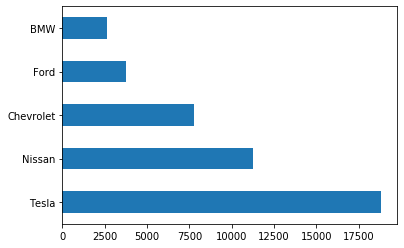

In [0]:
ev_pop['Make'].value_counts()[:5].plot(kind = 'barh')

In [0]:
# another way of making a pie plot, but no %

# ev_pop['Make'].value_counts().plot.pie(figsize=(10, 10))

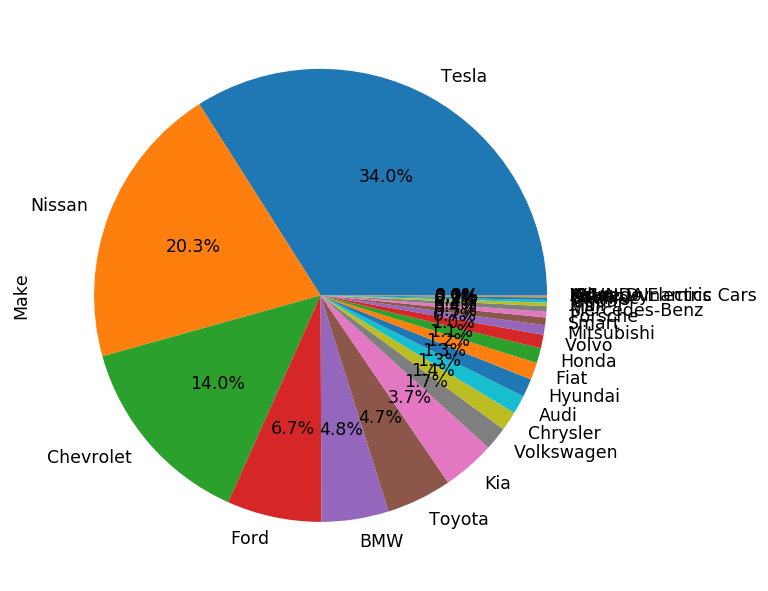

In [0]:
fig = plt.figure(figsize=(6,6), dpi=125)
ax = plt.subplot(111)
ev_pop['Make'].value_counts().plot(kind='pie', ax=ax, autopct='%1.1f%%', startangle=0, fontsize=10)

In [0]:
# average electric range for each car model

ev_pop.groupby('Make').mean()[['Electric Range', 'Base MSRP']].sort_values('Electric Range', ascending=False)

,Electric Range,Base MSRP
Make,,
Jaguar,234.000000,69500.000000
Tesla,218.974999,52231.840862
Chevrolet,113.139169,35722.205009
Volkswagen,105.925566,30421.217949
Kia,101.581407,32577.302505
Wheego Electric Cars,100.000000,32995.000000
Nissan,97.279330,30009.177973
Fiat,86.187040,31859.837997
Audi,83.761518,51673.983740


In [0]:
# max electric range for each car make

ev_pop.groupby('Make').max()[['Electric Range', 'Base MSRP']].sort_values('Electric Range', ascending=False)

,Electric Range,Base MSRP
Make,,
Tesla,289,110950.0
Hyundai,258,36950.0
Kia,239,38500.0
Chevrolet,238,41000.0
Jaguar,234,69500.0
Audi,204,74800.0
BMW,153,163300.0
Nissan,151,35200.0
Volkswagen,125,33450.0


In [0]:
# Looks like Jaguar only makes 1 electric vehicle, the I-Pace, which has an electric range of 234. 

ev_pop.loc[ev_pop['Make'] == 'Jaguar'].head()

,VIN (1-10),County,City,State,ZIP Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location
638,SADHD2S19K,Clark,Vancouver,WA,98685,2019,Jaguar,I-Pace,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,234,69500.0,18.0,269467663,NaN
725,SADHB2S12K,King,Bellevue,WA,98005,2019,Jaguar,I-Pace,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,234,69500.0,41.0,4794835,POINT (-122.168422 47.614824)
1130,SADHD2S11K,Spokane,Mead,WA,99021,2019,Jaguar,I-Pace,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,234,69500.0,4.0,112827970,POINT (-117.27063300000002 47.806385000000006)
1133,SADHD2S10L,King,Seattle,WA,98118,2020,Jaguar,I-PACE,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,234,NaN,37.0,8866889,POINT (-122.275593 47.54055)
2547,SADHD2S16K,King,Kirkland,WA,98033,2019,Jaguar,I-Pace,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,234,69500.0,45.0,475173072,POINT (-122.188994 47.678406)


In [0]:
# In comparison to Jaguar, Tesla makes a variety of models with various electric ranges.

ev_pop.loc[ev_pop['Make'] == 'Tesla'].head()

,VIN (1-10),County,City,State,ZIP Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location
1,5YJSA4H22F,Pierce,Tacoma,WA,98409,2015,Tesla,Model S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,208,69900.0,29.0,271292283,NaN
14,5YJSA1E20H,King,Renton,WA,98056,2017,Tesla,Model S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,210,68000.0,41.0,172883798,NaN
16,5YJ3E1EB5J,Skagit,Mount Vernon,WA,98273,2018,Tesla,Model 3,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,215,36000.0,10.0,475437343,NaN
18,5YJ3E1EA7J,King,Snoqualmie,WA,98065,2018,Tesla,Model 3,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,215,36000.0,5.0,171714301,NaN
19,5YJSA1E28H,King,Snoqualmie,WA,98065,2017,Tesla,Model S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,210,68000.0,5.0,238139695,NaN


### Analysis of Temperature in Washington State

One of the features that we are considering is the average temperature in Washington State over years.

Source: https://www.ncdc.noaa.gov/cag/statewide/time-series/

In [0]:
washington_state_annual_temperature = pd.read_csv(global_path + local_path + "/washington-state-annual-temperature.csv", header=4)
washington_state_annual_temperature['Date'] = [int(str(date)[:-2]) for date in washington_state_annual_temperature['Date']]

In [10]:
washington_state_annual_temperature.head()

,Date,Value,Anomaly
0,1990,47.3,1.2
1,1991,47.1,1.0
2,1992,48.6,2.5
3,1993,45.6,-0.5
4,1994,47.9,1.8


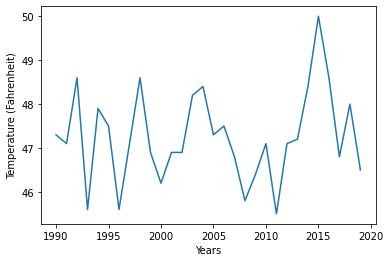

In [11]:
plt.xlabel('Years')
plt.ylabel('Temperature (Fahrenheit)')
plt.plot(washington_state_annual_temperature['Date'], washington_state_annual_temperature['Value']);

### Analysis of Income in Washington State

Another one of the features that we are considering including in our model is average income over year for households in Washington state.

Source: https://www.deptofnumbers.com/income/washington/

In [0]:
washington_state_income = pd.read_csv(global_path + local_path + "/washington-state-income.csv")

In [13]:
washington_state_income.head()

,Date,US,Washington
0,2019,61734,73010
1,2018,60883,72218
2,2017,60336,70979
3,2016,58856,68550
4,2015,57709,66353


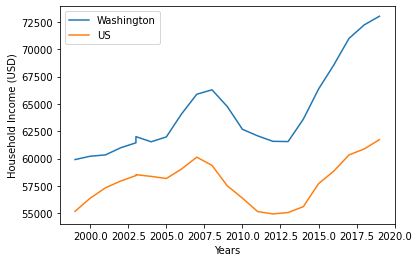

In [14]:
plt.xlabel('Years')
plt.ylabel('Household Income (USD)')
plt.plot(washington_state_income['Date'], washington_state_income['Washington'], label='Washington');
plt.plot(washington_state_income['Date'], washington_state_income['US'], label='US');
plt.legend();

### Analysis of Charging Stations in Washington State

In [0]:
# find number of charging stations in WA

### Louisville, KY Charging Stations

Dataset from Louisville, KY
<br>
Wish it contained data about how many charging points per station

In [0]:
louisville_charging = pd.read_excel(global_path + local_path + "/EV_Charging_Stations_Crowdsourced_Data.xlsx")

In [0]:
louisville_charging.head()

,OBJECTID,FID_EV_Charging_Suggestions,Name,Location,Date,Comments,CreationDate,NUMVOTES,COUNDIST,ZIPCODE,Longitude,Latitude
0,1,132,Kosmosdale,"Kosmos Cement; on the way to/from Fort Knox, R...",2017-10-26 14:53:48,NaN,2017-10-26 18:42:33,0,14,40272,-85.908334,38.037364
1,2,133,LG&E Mill Creek Station,Get your charge at the source!,2017-10-26 14:53:48,NaN,2017-10-26 18:44:02,0,14,40272,-85.909053,38.054942
2,3,116,Jefferson Memorial Forest Welcome Center,"Park with hiking trails, fishing, activities",2017-10-26 14:53:48,NaN,2017-10-26 17:23:07,1,13,40118,-85.767432,38.085280
3,4,234,Walmart Okolona,Walmart at Antle Drive and Standiford Plaza Drive,2017-11-08 14:06:33,NaN,2017-11-08 14:10:53,1,13,40229,-85.664494,38.088768
4,5,130,Preston Crossings,Shopping; offices; stopping point to/from Bull...,2017-10-26 14:53:48,NaN,2017-10-26 18:35:18,1,13,40229,-85.670261,38.092417


In [0]:
louisville_charging.shape

(238, 12)

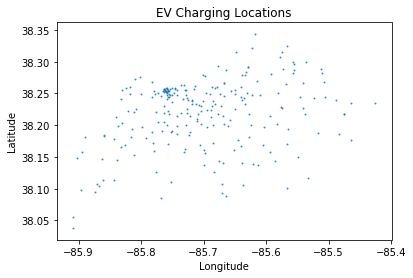

In [0]:
louisville_charging.plot(kind = "scatter", x = "Longitude", y = "Latitude", alpha = 0.75, s = 1, title='EV Charging Locations')

In [0]:
louisville_charging.groupby('ZIPCODE').size().sort_values(ascending=False)

ZIPCODE
40202    28
40207    18
40205    15
40206    12
40216    11
40213    10
40223     9
40299     9
40272     8
40241     8
40203     8
40204     8
40211     8
40219     7
40208     7
40222     6
40291     6
40209     5
40217     5
40214     5
40245     5
40229     4
40258     4
40212     4
40218     4
40220     4
40228     3
40215     3
40059     3
40210     2
40243     2
40225     2
40118     2
40023     2
40242     1
dtype: int64

### UK Charging Stations

In [0]:
# installing odfpy to open odf files with pandas

# import sys
# !{sys.executable} -m pip install odfpy

In [0]:
uk_charging = pd.read_excel(global_path + local_path + "/electric-vehicle-charging-device-statistics-october-2019.ods", engine="odf")

In [0]:
uk_charging.head()

,Table 1,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5
0,Publicly available electric vehicle charging d...,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN
2,LA / Region Code,Local Authority / Region Name,Total publiccharging devices,Total public rapidcharging devices,"Charging devices per100,000 population","Rapid Devices per100,000 population"
3,K02000001,UNITED KINGDOM,15116,2495,22.7529,3.75552
4,K03000001,GREAT BRITAIN,14821,2476,22.9591,3.83555


Will need to reformat the ods file to get it to be more readable and able to be processed by pandas. currently is unusable

---

## EV Adoption Forecasting Model

Now that we have explored different kinds of datasets, we have a good idea of what variables to consider and thus can proceed to training a machine learning model that forecasts the adoption rate of EVs in future years.

### Defining Independent and Dependent Variables in our Model

In [0]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

Below, we are cleaning the datasets that we imported during the EDA portion and extracting the variables that we will be including in our model. 

#### EV Registration DataFrame

We will get most of those variables from the EV registration dataframe that we explored in the EDA portion, including year of purchase and ZIP code.

In [17]:
ev_reg.head()

,Clean Alternative Fuel Vehicle Type,VIN (1-10),Model Year,Make,Model,New or Used Vehicle,Sale Price,DOL Transaction Date,Transaction Type,Transaction Year,Electric Vehicle Fee Paid,County,City,Zip,Electric Range,Base MSRP,2015 HB 2778 Exemption Eligibility,Sale Date,Vehicle Primary Use,State of Residence,DOL Vehicle ID,Legislative District,2019 HB 2042 Clean Alternative Fuel Vehicle (CAFV) Eligibility,Meets 2019 HB 2042 Electric Range Requirement,Meets 2019 HB 2042 Sale Date Requirement,Meets 2019 HB 2042 Sale Price/Value Requirement
0,Battery Electric Vehicle (BEV),5YJSA1E20J,2018,Tesla,Model S,Used,0,May 15 2019,Registration Renewal,2019,Yes,Clark,Camas,98607.0,249,74500.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,241150857,18.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
1,Battery Electric Vehicle (BEV),5YJSA1E20J,2018,Tesla,Model S,Used,0,September 13 2019,Registration Renewal,2019,Yes,King,Bothell,98011.0,249,74500.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,139598161,1.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
2,Battery Electric Vehicle (BEV),5YJSA1E18G,2016,Tesla,Model S,Used,0,November 30 2018,Registration Renewal,2018,Yes,Grant,Quincy,98848.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,348761374,13.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
3,Battery Electric Vehicle (BEV),5YJSA1E18G,2016,Tesla,Model S,New,0,February 03 2017,Original Registration,2017,No,King,Sammamish,98074.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,171877849,45.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False
4,Battery Electric Vehicle (BEV),5YJSA1E18G,2016,Tesla,Model S,Used,0,December 26 2017,Registration Renewal,2017,Yes,King,Sammamish,98074.0,210,66000.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",NaN,Passenger,WA,171877849,45.0,"TRANSACTION NOT ELIGIBLE: Non-sale, registrati...",True,False,False


We will first clean up `ev_reg` and then aggregate the dataframe over year and ZIP code.

In [18]:
# Clean zip code column
ev_reg = ev_reg[ev_reg['State of Residence'] == 'WA']
ev_reg = ev_reg.dropna(subset=['Zip'])
ev_reg = ev_reg[ev_reg['Transaction Year'] != 2020]
ev_reg['Zip'] = ev_reg['Zip'].astype(int).astype(str)

# Aggregate by zip code and then clean
label_ev_reg = ev_reg.groupby(['Transaction Year', 'Zip']).count()[['Make']]
label_ev_reg.reset_index(inplace=True) 
label_ev_reg = label_ev_reg.rename(columns={'Transaction Year': 'Year', 'Make': 'Count'})

# Sort by year and then zip code
label_ev_reg['Zip'] = label_ev_reg['Zip'].astype(int)
label_ev_reg = label_ev_reg.sort_values(['Year', 'Zip'])
label_ev_reg['Zip'] = label_ev_reg['Zip'].astype(str)
label_ev_reg

,Year,Zip,Count
0,2010,98004,1
1,2010,98006,1
2,2010,98014,1
3,2010,98027,2
4,2010,98029,1
...,...,...,...
3587,2019,99361,3
3588,2019,99362,130
3589,2019,99401,1
3590,2019,99402,4


##### ZIP Code One-Hot Encoding

Since ZIP code is a categorical variable that we would like to use as one of our features, we need to perform one-hot encoding so that it is suitable for use in our model.

Let us define a helper function that allows us to more easily one-hot encode a categorical column in a dataframe.

In [0]:
def one_hot_encode(col_name, df):
  # Get values to encode
  col = df[col_name]
  values = np.array(col)

  # Encode each value as an integer index
  encoder_label = LabelEncoder()
  int_encoded = encoder_label.fit_transform(values)
  label_zip_code = list(encoder_label.classes_)

  # Binary encode using one-hot encoder
  one_hot_encoder = OneHotEncoder(sparse=False)
  int_encoded = int_encoded.reshape(len(int_encoded), 1)
  one_hot_encoded = one_hot_encoder.fit_transform(int_encoded)

  # Concatenate one-hot encoding to the given dataframe
  df = df.drop(col_name, axis=1)
  df = pd.concat([df, pd.DataFrame(data=one_hot_encoded, columns=label_zip_code)], axis=1)

  return df

Let us call the helper function to OHE the ZIP code column of `label_ev_reg`.

In [20]:
label_ev_reg_ohe = one_hot_encode('Zip', label_ev_reg)
label_ev_reg_ohe

,Year,Count,98001,98002,98003,98004,98005,98006,98007,98008,98010,98011,98012,98014,98019,98020,98021,98022,98023,98024,98025,98026,98027,98028,98029,98030,98031,98032,98033,98034,98036,98037,98038,98039,98040,98042,98043,98045,98047,98050,...,99202,99203,99204,99205,99206,99207,99208,99212,99216,99217,99218,99220,99223,99224,99301,99320,99323,99324,99326,99328,99330,99336,99337,99338,99343,99344,99347,99348,99349,99350,99352,99353,99354,99357,99360,99361,99362,99401,99402,99403
0,2010,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2010,1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2010,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2010,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,2010,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3587,2019,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3588,2019,130,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3589,2019,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3590,2019,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


As a mildly unrelated side note, we previously considered using the `ev_pop` dataframe and the model year of each electric vehicle as a proxy for actual electric vehicle purchases, but since we discovered `ev_reg` we will not use this anymore.

In [21]:
label_ev_pop = ev_pop.groupby('Model Year').count()[['State']].loc[2010:2019, :]
label_ev_pop.head()

,State
Model Year,
2010,31
2011,971
2012,1883
2013,5136
2014,3959


#### Washington State Temperature DataFrame

Below we are cleaning the data for the Washington state temperatures, which we will merge to the EV registration dataframe.

In [22]:
wa_temp_clean = washington_state_annual_temperature[(washington_state_annual_temperature['Date'] >= 2010) \
                                                    & (washington_state_annual_temperature['Date'] <= 2020)].reset_index()
wa_temp_clean = wa_temp_clean.merge(right=label_ev_reg, how='outer', left_on='Date', right_on='Year')[['Date', 'Value', 'Anomaly']]
wa_temp_clean

,Date,Value,Anomaly
0,2010,47.1,1.0
1,2010,47.1,1.0
2,2010,47.1,1.0
3,2010,47.1,1.0
4,2010,47.1,1.0
...,...,...,...
3587,2019,46.5,0.4
3588,2019,46.5,0.4
3589,2019,46.5,0.4
3590,2019,46.5,0.4


#### Washington State Income DataFrame

Below we are cleaning the data for the Washington income temperatures, which we will merge to the EV registration dataframe.

In [23]:
wa_income_clean = washington_state_income[washington_state_income['Date'] >= 2010].sort_values('Date', ascending=True).reset_index()
wa_income_clean = wa_income_clean.merge(right=label_ev_reg, how='outer', left_on='Date', right_on='Year')[['Date', 'US', 'Washington']]
wa_income_clean

,Date,US,Washington
0,2010,56388,62680
1,2010,56388,62680
2,2010,56388,62680
3,2010,56388,62680
4,2010,56388,62680
...,...,...,...
3587,2019,61734,73010
3588,2019,61734,73010
3589,2019,61734,73010
3590,2019,61734,73010


#### Constructing $X$ Matrix of Features and $y$ Vector of Labels 

We are now constructing our set of independent variables and putting it in the matrix $X$.

In [24]:
X = label_ev_reg_ohe.copy()
X = X.drop('Count', axis=1)
X['Temperature'] = wa_temp_clean['Value']
X['Income'] = wa_income_clean['Washington']
X

,Year,98001,98002,98003,98004,98005,98006,98007,98008,98010,98011,98012,98014,98019,98020,98021,98022,98023,98024,98025,98026,98027,98028,98029,98030,98031,98032,98033,98034,98036,98037,98038,98039,98040,98042,98043,98045,98047,98050,98051,...,99204,99205,99206,99207,99208,99212,99216,99217,99218,99220,99223,99224,99301,99320,99323,99324,99326,99328,99330,99336,99337,99338,99343,99344,99347,99348,99349,99350,99352,99353,99354,99357,99360,99361,99362,99401,99402,99403,Temperature,Income
0,2010,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.1,62680
1,2010,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.1,62680
2,2010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.1,62680
3,2010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.1,62680
4,2010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.1,62680
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3587,2019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,46.5,73010
3588,2019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,46.5,73010
3589,2019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,46.5,73010
3590,2019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,46.5,73010


Below we have defined our dependent variable, which is the sales of EVs per year (which previously used model year from `ev_pop` as a proxy). NOTE that the actual $y$ vector only includes the Count column, but we are keeping the Year and Zip columns for filtering purposes.

In [25]:
y = label_ev_reg[['Year', 'Zip', 'Count']]
y

,Year,Zip,Count
0,2010,98004,1
1,2010,98006,1
2,2010,98014,1
3,2010,98027,2
4,2010,98029,1
...,...,...,...
3587,2019,99361,3
3588,2019,99362,130
3589,2019,99401,1
3590,2019,99402,4


### Training our Model

First, we need to obtain a train-test split, which for our dataset we will use 80% to train and 20% to validate. For our time series model, we will use the years 2010-2017 as our training data, and the years 2018-2019 as testing.

In [0]:
X_train = X[(X['Year'] >= 2010) & (X['Year'] <= 2017)]
X_test = X[(X['Year'] >= 2018) & (X['Year'] <= 2019)]

y_train = y[(y['Year'] >= 2010) & (y['Year'] <= 2017)]
y_test = y[(y['Year'] >= 2018) & (y['Year'] <= 2019)]

#### Linear Model Hypothesis

We preliminarily hypothesize that the EV adoption numbers follow a linear pattern with respect to our features, so we will fit our data using a linear regression model.

In [27]:
model = LinearRegression()
model.fit(X_train, y_train['Count'])

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In order to make a prediction input that is suitable for our model, we need to include 530 features, 527 are one-hot encoded ZIP code features. To make this a bit simpler to use, we will define a helper function below.

In [0]:
def make_prediction_input(year, zip_code, temp, income):
  col = label_ev_reg['Zip']
  values = np.array(col)

  # Encode each value as an integer index
  label_encoder = LabelEncoder()
  integer_encoded = label_encoder.fit_transform(values)
  zip_code_labels = list(label_encoder.classes_)

  zip_code_input = list(np.zeros(len(zip_code_labels)))
  zip_code_index = label_encoder.transform([str(zip_code)])[0]
  zip_code_input[zip_code_index] = 1
  
  pred_input = []
  pred_input.append(year)
  pred_input.extend(zip_code_input)
  pred_input.append(temp)
  pred_input.append(income)
  return pred_input

Here is a sample of our model predicting the EV population in the 98052 ZIP code in Washington state in the year 2021 when the average temperature is 48 degrees Fahrenheit and the average income is $74000.

In [29]:
pred_input = make_prediction_input(2021, 98052, 48, 74000)
model.predict([pred_input])

array([760.73254967])

After training our model, we can predict EVs adoption numbers given the year, ZIP code, temperature, and income data of Washington state.

##### Evaluating Our Linear Model

As this is a regression task, we can evaluate our model by taking the mean squared error of the prediction vs the true label.

In [0]:
from sklearn.metrics import mean_squared_error

First let us recover the zip code labels from the `label_ev_reg` dataframe.

In [0]:
# Encode each value as an integer index
label_encoder = LabelEncoder()
integer_encoded = label_encoder.fit_transform(np.array(label_ev_reg['Zip']))
zip_code_labels = list(label_encoder.classes_)

Then, we will evaluate how well we trained our model onto our dataset by using our linear model to predict over each ZIP code of the training data, and then calculate the mean squared error between the prediction and the true result.

2139.0690885755726

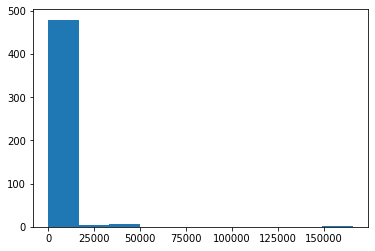

In [32]:
# Predict over data from each zip code
ev_adoption_linear_train = {}
for zip_code in zip_code_labels:
  train_vals = X_train[X_train[zip_code] == 1]
  if len(train_vals) > 0:
    ev_adoption_linear_train[zip_code] = model.predict(train_vals)

# Compute mse between predicted values and true values
mse_dict_train = {}
zip_code_train_outliers = []
for zip_code, nums in ev_adoption_linear_train.items():
  mse = mean_squared_error(nums, y_train[y_train['Zip'] == zip_code]['Count'])
  mse_dict_train[zip_code] = mse

# Plot histogram of mse per zip code, and print out mean of mse over zip codes
plt.hist(mse_dict_train.values());
np.mean(list(mse_dict_train.values()))

Next, we will evaluate how well our model generalizes and can predict future outcomes by predicting over each ZIP code of the test data, and then calculate the mean squared error between the prediction and the true result.

1.2101972575323288e+20

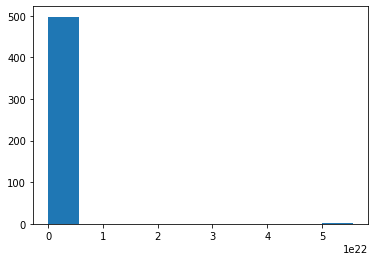

In [45]:
# Predict over data for each zip code of test segment
ev_adoption_linear_test = {}
for zip_code in zip_code_labels:
  test_vals = X_test[X_test[zip_code] == 1]
  if len(test_vals) > 0:
    ev_adoption_linear_test[zip_code] = model.predict(test_vals)

# Compute mse between predicted values and true values
mse_dict_test = {}
for zip_code, nums in ev_adoption_linear_test.items():
  mse = mean_squared_error(nums, y_test[y_test['Zip'] == zip_code]['Count'])
  mse_dict_test[zip_code] = mse

# Plot histogram of mse per zip code, and print out mean of mse over zip codes
plt.hist(mse_dict_test.values());
np.mean(np.array(list(mse_dict_test.values())))

##### Modifications to our Linear Model

We can see from our histogram of mean squared errors that our linear model does not generalize very well for a handful of ZIP codes. This is likely due to the sparsity or perhaps the general lack of the data for those particular ZIP codes. For the sake of this model, let us remove these outlier ZIP codes from our data set and only focus on ZIP codes that our model can perform decently on.

To do this, let us remove the ZIP codes with high mean squared error by placing a threshold that should filter them out.

In [46]:
# Filter out high mse zip code, place in list
threshold = 1e10
zip_code_test_outliers = []
for key, val in list(mse_dict_test.items()):
  if val > threshold:
    zip_code_test_outliers.append(key)
    mse_dict_test.pop(key)

# Print out new mean of filtered mse
np.mean(np.array(list(mse_dict_test.values())))

29926.971519817627

We can see now that the average mean squared errors over each ZIP code is now a lot lower a more reasonable than with the filtered out ZIP codes.

Now, in order modify our linear model to disregard the filtered out ZIP codes, we need to prune them out starting at the level of `label_ev_reg`, and then we need to propagate those changes down to the $X$ matrix, $y$ vector, and the train-test split.

In [0]:
# Remove outlier zip codes from the dataframe, then one hot encode
label_ev_reg_pruned = label_ev_reg[~label_ev_reg['Zip'].isin(zip_code_test_outliers)].reset_index(drop=True)
label_ev_reg_pruned_ohe = one_hot_encode('Zip', label_ev_reg_pruned)

# Create X matrix
X = label_ev_reg_pruned_ohe.copy()
X = X.drop('Count', axis=1)
X['Temperature'] = wa_temp_clean['Value']
X['Income'] = wa_income_clean['Washington']

# Create y vector
y = label_ev_reg_pruned[['Year', 'Zip', 'Count']]

# Generate train test split
X_train = X[(X['Year'] >= 2010) & (X['Year'] <= 2017)]
X_test = X[(X['Year'] >= 2018) & (X['Year'] <= 2019)]

y_train = y[(y['Year'] >= 2010) & (y['Year'] <= 2017)]
y_test = y[(y['Year'] >= 2018) & (y['Year'] <= 2019)]

Finally, we will retrain our linear model on the pruned dataset.

In [48]:
model = LinearRegression()
model.fit(X_train, y_train['Count'])

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

#### Auto Regressive Integrated Moving Average Model (ARIMA) 

Since we are working with time series data, we will also explore using the ARIMA model.

In [0]:
from statsmodels.tsa.arima_model import ARIMA

The ARIMA model only takes in a series as input and no ZIP code categorical variable, so let us train our model on only some of the more consequential ZIP codes with more data.

In [50]:
label_ev_reg.sort_values('Count', ascending=False).head(10)

,Year,Zip,Count
3138,2019,98052,2313
2664,2018,98052,1899
3125,2019,98033,1505
3166,2019,98115,1420
3103,2019,98004,1361
3105,2019,98006,1359
2212,2017,98052,1343
3110,2019,98012,1279
3150,2019,98074,1259
2651,2018,98033,1239


Let us choose the 98033 ZIP code, which corresponds to Kirkland, WA, a city in King County, and let us run the ARIMA model through the time series data provided there.

Predicted=916.924032, Expected=1239.000000
Predicted=1537.337205, Expected=1505.000000
Test MSE: 52389.312


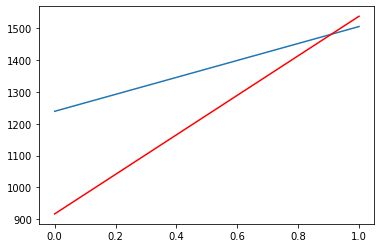

In [55]:
predictions = list()
train = np.array(label_ev_reg[label_ev_reg['Zip'] == '98033']['Count']).astype(float)[:8]
test = np.array(y_test[y_test['Zip'] == '98033']['Count'].astype(float))
history = [x for x in train]

for t in range(len(test)):
	arima_model = ARIMA(history, order=(2,1,0))
	arima_model_fit = arima_model.fit(disp=0)
	output = arima_model_fit.forecast()
 
	pred = output[0]
	predictions.append(pred)
	true_val = test[t]
	history.append(true_val)
	print('Predicted=%f, Expected=%f' % (pred, true_val))
 
error = mean_squared_error(test, predictions)
print('Test MSE: %.3f' % error)

plt.plot(test)
plt.plot(predictions, color='red')
plt.show()

After testing the ARIMA model on the the 98033 ZIP code, we saw that it does not actually give us much of an improvement compared to the linear model in terms of mean squared error.

In addition, after doing a bit more research we realized that ARIMA would not be the best model because:

1. Our time series is not necessarily a stationary series, and we do not have enough data to prove that.
2. Our input data is meant to be multivariate, but ARIMA only allows for univariate inputs. This makes training over multiple ZIP codes significantly more difficult.

### Using our Model to Forecast EV Population Numbers

Let us try to predict the next 30 years, but first we need to generate data for temperature and income in Washington based on some hypotheses.

#### Generating Washington Temperature Data 2020-2050

Below we hypothesize that Washington state temperature follows a linear pattern, and thus we will generate data based on a linear model. We will also add Gaussian noise based on the standard deviation of the known temperatures.

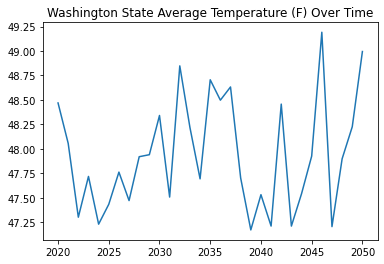

In [56]:
washington_temp_model = LinearRegression()
washington_temp_model.fit(wa_temp_clean[['Date']], wa_temp_clean['Value'])
washington_temp_data = washington_temp_model.predict(np.arange(2020, 2051)[:, np.newaxis])
washington_temp_data = np.add(washington_temp_data, np.random.normal(0, wa_temp_clean['Value'].std() / 2, 31))

plt.title('Washington State Average Temperature (F) Over Time')
plt.plot(np.arange(2020, 2051), washington_temp_data);

wa_future_temp_df = pd.DataFrame(data=np.transpose([np.arange(2020, 2051), washington_temp_data]), columns=['Year', 'Temp'])

#### Generating Washington Income Data 2020-2050

Below we hypothesize that Washington state income follows a linear pattern, and thus we will generate data based on a linear model. We will also add Gaussian noise based on the standard deviation of the known income.

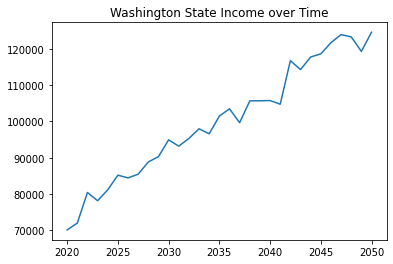

In [57]:
washington_income_model = LinearRegression()
washington_income_model.fit(wa_income_clean[['Date']], wa_income_clean['Washington'])
washington_income_data = washington_income_model.predict(np.arange(2020, 2051)[:, np.newaxis])
washington_income_data = np.add(washington_income_data, np.random.normal(0, wa_income_clean['Washington'].std() / 2, 31))

plt.title('Washington State Income over Time')
plt.plot(np.arange(2020, 2051), washington_income_data);

wa_future_income_df = pd.DataFrame(data=np.transpose([np.arange(2020, 2051), washington_income_data]), columns=['Year', 'Income'])

#### Create Future Matrix to Predict On

Now we will predict on the $X_{future}$, which is based on the future data that we have generated.

In [58]:
# Create dataframe
X_future = pd.DataFrame()
X_future['Year'] = np.arange(2020, 2051)
X_future['key'] = 0

# Get zip code labels
label_encoder = LabelEncoder()
label_encoder.fit_transform(np.array(ev_reg['Zip']))
zip_code_labels = list(label_encoder.classes_)

# Remove outlier zip codes which cannot be predicted well upon
zip_code_labels = [c for c in zip_code_labels if c not in zip_code_test_outliers]

# Cross join year with zip codes
zip_codes_df = pd.DataFrame(data=zip_code_labels, columns=['Zip'])
zip_codes_df['key'] = 0
X_future = X_future.merge(zip_codes_df, how='outer', on='key').drop('key', axis=1)

# One-hot encode zip codes
X_future = one_hot_encode('Zip', X_future)

formatter = lambda x: x / 10

# Add future Washington temperatures and income
X_future = X_future.merge(wa_future_temp_df, how='outer', on='Year')
X_future = X_future.merge(wa_future_income_df, how='outer', on='Year')
X_future

,Year,98001,98002,98003,98004,98005,98006,98007,98008,98010,98011,98012,98014,98019,98020,98021,98022,98023,98024,98025,98026,98027,98028,98029,98030,98031,98032,98033,98034,98036,98037,98038,98039,98040,98042,98043,98045,98047,98050,98051,...,99202,99203,99204,99205,99206,99207,99208,99212,99216,99217,99218,99220,99223,99224,99301,99320,99323,99324,99326,99328,99330,99336,99337,99338,99344,99347,99348,99349,99350,99352,99353,99354,99357,99361,99362,99401,99402,99403,Temp,Income
0,2020,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,48.469221,70090.367503
1,2020,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,48.469221,70090.367503
2,2020,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,48.469221,70090.367503
3,2020,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,48.469221,70090.367503
4,2020,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,48.469221,70090.367503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15216,2050,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,48.994896,124579.396487
15217,2050,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,48.994896,124579.396487
15218,2050,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,48.994896,124579.396487
15219,2050,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,48.994896,124579.396487


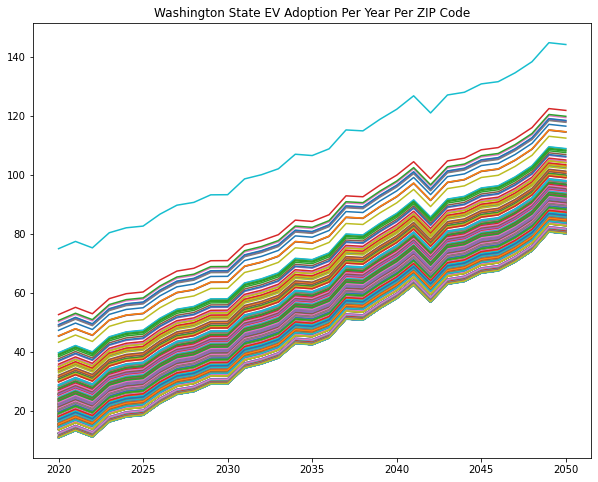

In [59]:
ev_adoption_futures = {}

for zip_code in zip_code_labels:
  ev_adoption_futures[zip_code] = formatter(model.predict(X_future[X_future[zip_code] == 1]))

plt.figure(figsize=(10, 8))
plt.title('Washington State EV Adoption Per Year Per ZIP Code')
for zip_code, nums in ev_adoption_futures.items():
  plt.plot(np.arange(2020, 2051), nums);

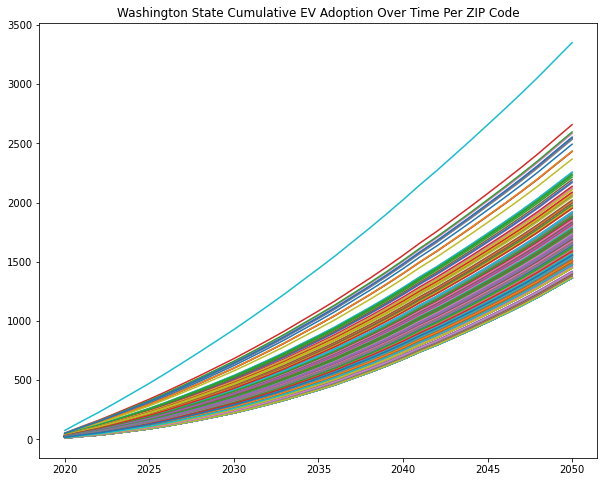

In [60]:
plt.figure(figsize=(10, 8))
plt.title('Washington State Cumulative EV Adoption Over Time Per ZIP Code')

for zip_code, nums in ev_adoption_futures.items():
  plt.plot(np.arange(2020, 2051), np.cumsum(nums));

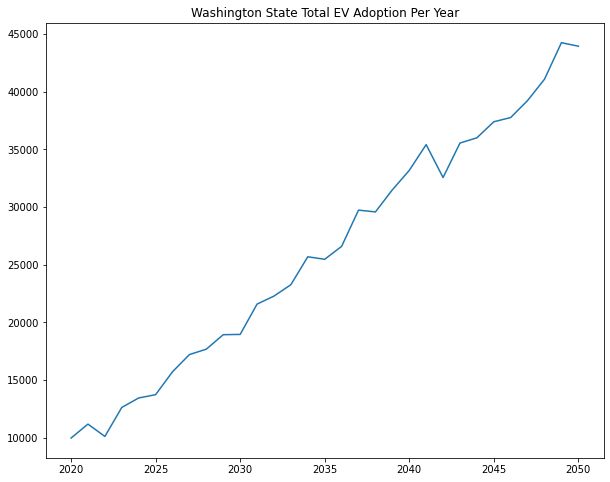

In [61]:
plt.figure(figsize=(10, 8))
plt.title('Washington State Total EV Adoption Per Year')
plt.plot(np.arange(2020, 2051), np.sum(np.array([arr for arr in ev_adoption_futures.values()]), axis=0));

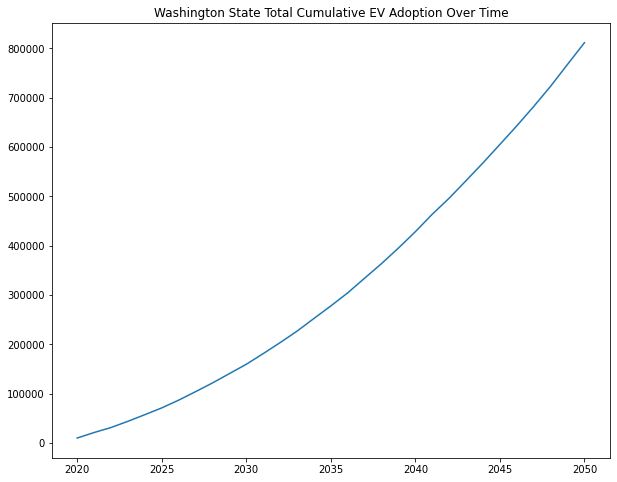

In [62]:
plt.figure(figsize=(10, 8))
plt.title('Washington State Total Cumulative EV Adoption Over Time')
plt.plot(np.arange(2020, 2051), np.cumsum(np.sum(np.array([arr for arr in ev_adoption_futures.values()]), axis=0)));

In [63]:
np.cumsum(np.sum(np.array([arr for arr in ev_adoption_futures.values()]), axis=0))

array([  9966.42288084,  21139.78313255,  31244.20246019,  43864.54810677,
        57305.43520126,  71031.16659641,  86744.25871983, 103947.41186829,
       121621.02523842, 140549.10081949, 159499.32107296, 181078.98620329,
       203354.17254524, 226617.9572897 , 252301.49631472, 277766.76689043,
       304352.80320759, 334082.14451942, 363655.22536783, 395142.21632709,
       428313.00890913, 463720.93382053, 496274.8824605 , 531819.56936045,
       567819.7719655 , 605209.43373308, 642968.71181927, 682203.29741478,
       723287.30952272, 767535.54114742, 811479.40944023])

Here we see that in total, our model predicts that Washington state will have over 800,000 EVs by 2050.

---

## Electrical Infrastructure Sustainability Model

Now that we have our forecasting model, we can use its outputs to analyze whether the current electrical infrastructural capacity of our selected geographic region can handle the increased number of EVs.

### Washington State Electrical Infrastructure

We will explore the electrical production and electrical usage of Washington State, and we will tie this data in with the influx of the EV population that we saw earlier. NOTE that all of the energy numbers are in megawatthours (MWh).

In [0]:
energy_annual_generation = pd.read_csv(global_path + local_path + "/energy_annual_generation_state.csv", header=1).iloc[:, : 5]
energy_sales_annual = pd.read_csv(global_path + local_path + "/energy_sales_annual.csv", header=1)

Here we have a dataset which has data with a detailed breakdown of energy generation per state and through what energy source starting from 1990 to 2018.

In [65]:
energy_annual_generation.head()

,YEAR,STATE,TYPE OF PRODUCER,ENERGY SOURCE,GENERATION (Megawatthours)
0,1990,AK,Total Electric Power Industry,Total,"5,599,506"
1,1990,AK,Total Electric Power Industry,Coal,"510,573"
2,1990,AK,Total Electric Power Industry,Hydroelectric Conventional,"974,521"
3,1990,AK,Total Electric Power Industry,Natural Gas,"3,466,261"
4,1990,AK,Total Electric Power Industry,Petroleum,"497,116"


Meanwhile here we have a dataset which has a breakdown of energy consumption per state per year from 1990 to 2018.

In [66]:
energy_sales_annual.head()

,Year,State,Industry Sector Category,Residential,Commercial,Industrial,Transportation,Other,Total
0,2018,AK,Total Electric Industry,"1,974,906","2,646,058","1,351,503",0,NaN,"5,972,467"
1,2018,AL,Total Electric Industry,"33,080,380","23,483,072","33,717,004",0,NaN,"90,280,456"
2,2018,AR,Total Electric Industry,"19,259,204","12,278,279","18,064,787",438,NaN,"49,602,708"
3,2018,AZ,Total Electric Industry,"34,660,297","29,683,550","13,994,441","8,014",NaN,"78,346,302"
4,2018,CA,Total Electric Industry,"89,099,985","115,786,492","49,587,913","749,882",NaN,"255,224,272"


Let us filter these dataframes so that we are only focusing on Washington state.

In [67]:
energy_annual_generation_wa = energy_annual_generation[(energy_annual_generation['STATE'] == 'WA') & \
                         (energy_annual_generation['TYPE OF PRODUCER'] == 'Total Electric Power Industry')].reset_index(drop=True)

energy_annual_generation_wa['YEAR'] = [int(year) for year in energy_annual_generation_wa['YEAR']]
energy_annual_generation_wa['GENERATION (Megawatthours)'] = [int(num.replace(',', '')) for num in energy_annual_generation_wa['GENERATION (Megawatthours)']]

energy_annual_generation_wa.head()

,YEAR,STATE,TYPE OF PRODUCER,ENERGY SOURCE,GENERATION (Megawatthours)
0,1990,WA,Total Electric Power Industry,Total,102071533
1,1990,WA,Total Electric Power Industry,Coal,7390279
2,1990,WA,Total Electric Power Industry,Hydroelectric Conventional,87466708
3,1990,WA,Total Electric Power Industry,Natural Gas,288058
4,1990,WA,Total Electric Power Industry,Nuclear,5742027


In [68]:
energy_sales_annual_wa = energy_sales_annual[(energy_sales_annual['State'] == 'WA') \
                        & (energy_sales_annual['Industry Sector Category'] == 'Total Electric Industry')].reset_index(drop=True)

energy_sales_annual_wa['Year'] = [int(year) for year in energy_sales_annual_wa['Year']]
energy_sales_annual_wa['Total'] = [int(num.replace(',', '')) for num in energy_sales_annual_wa['Total']]

energy_sales_annual_wa.head()

,Year,State,Industry Sector Category,Residential,Commercial,Industrial,Transportation,Other,Total
0,2018,WA,Total Electric Industry,"35,338,978","29,396,404","25,263,272","7,137",NaN,90005791
1,2017,WA,Total Electric Industry,"37,282,901","29,799,505","24,858,604","7,162",NaN,91948172
2,2016,WA,Total Electric Industry,"34,211,748","28,989,062","25,678,420","6,086",NaN,88885316
3,2015,WA,Total Electric Industry,"34,071,987","29,266,512","26,772,299","5,288",NaN,90116086
4,2014,WA,Total Electric Industry,"35,082,958","29,040,310","28,012,775","4,734",NaN,92140777


#### Proportion of Renewable Energy Generation

We are also interested in the energy proportion that is generated from clean, renewable resources, so we will also calculate the breakdown of energy generation by source.

In [0]:
energy_proportion = []
curr_year, curr_total = 0, 0
for index, row in energy_annual_generation_wa.iterrows():
  if row[0] != curr_year:
    curr_year = row[0]
    curr_total = row[4]
    energy_proportion.append(1)
  else:
    energy_proportion.append(row[4] / curr_total)

energy_annual_generation_wa['Proportion of Energy in Year'] = energy_proportion

Here is a snapshot of what the proportions column looks like, where `ENERGY SOURCE == Total` equals 1 because it represents total generation.

In [71]:
energy_annual_generation_wa[energy_annual_generation_wa['YEAR'] == 2018]

,YEAR,STATE,TYPE OF PRODUCER,ENERGY SOURCE,GENERATION (Megawatthours),Proportion of Energy in Year
330,2018,WA,Total Electric Power Industry,Total,116756729,1.000000
331,2018,WA,Total Electric Power Industry,Coal,5382866,0.046103
332,2018,WA,Total Electric Power Industry,Pumped Storage,28237,0.000242
333,2018,WA,Total Electric Power Industry,Hydroelectric Conventional,80883377,0.692751
334,2018,WA,Total Electric Power Industry,Natural Gas,10535078,0.090231
335,2018,WA,Total Electric Power Industry,Nuclear,9708441,0.083151
336,2018,WA,Total Electric Power Industry,Other Gases,430840,0.003690
337,2018,WA,Total Electric Power Industry,Other,59265,0.000508
338,2018,WA,Total Electric Power Industry,Petroleum,23656,0.000203
339,2018,WA,Total Electric Power Industry,Solar Thermal and Photovoltaic,1695,0.000015


We will calculate the average renewable energies total by filtering by renewable energy sources, such as hydroelectric and solar, grouping and summing over year, and then taking the average of the proportions over the years.

In [72]:
renewable_energy = ['Hydroelectric Conventional', 'Solar Thermal and Photovoltaic', 'Other Biomass', 'Wind']
energy_annual_generation_wa[energy_annual_generation_wa['ENERGY SOURCE'].isin(renewable_energy)].groupby('YEAR').sum()['Proportion of Energy in Year'].mean()

0.7713744558253908

We can see here that around 77% of Washington state's energy generation comes from renewable sources, which is quite remarkable.

#### Calculating Energy Surplus per Year

Since we have the energy generation and consumption numbers per year, we can merge the tables together and calculate the average surplus.

In [73]:
merged_table = energy_annual_generation_wa[energy_annual_generation_wa['ENERGY SOURCE'] == 'Total'] \
              .merge(right=energy_sales_annual_wa, how='inner', left_on='YEAR', right_on='Year')

merged_table.head()

,YEAR,STATE,TYPE OF PRODUCER,ENERGY SOURCE,GENERATION (Megawatthours),Proportion of Energy in Year,Year,State,Industry Sector Category,Residential,Commercial,Industrial,Transportation,Other,Total
0,1990,WA,Total Electric Power Industry,Total,102071533,1.0,1990,WA,Total Electric Industry,"28,808,844","17,682,979","40,711,980",NaN,"3,842,348",91046151
1,1991,WA,Total Electric Power Industry,Total,102870562,1.0,1991,WA,Total Electric Industry,"29,889,138","18,143,350","40,838,988",NaN,"3,842,033",92713509
2,1992,WA,Total Electric Power Industry,Total,86482429,1.0,1992,WA,Total Electric Industry,"28,435,824","18,727,289","38,331,617",NaN,"3,824,586",89319316
3,1993,WA,Total Electric Power Industry,Total,87995776,1.0,1993,WA,Total Electric Industry,"30,932,034","19,530,991","36,562,815",NaN,"3,446,771",90472611
4,1994,WA,Total Electric Power Industry,Total,88586476,1.0,1994,WA,Total Electric Industry,"29,672,858","19,752,439","34,065,131",NaN,"3,642,969",87133397


In [74]:
merged_table['Energy Surplus'] = merged_table['GENERATION (Megawatthours)'] - merged_table['Total'] 
merged_table.head()

,YEAR,STATE,TYPE OF PRODUCER,ENERGY SOURCE,GENERATION (Megawatthours),Proportion of Energy in Year,Year,State,Industry Sector Category,Residential,Commercial,Industrial,Transportation,Other,Total,Energy Surplus
0,1990,WA,Total Electric Power Industry,Total,102071533,1.0,1990,WA,Total Electric Industry,"28,808,844","17,682,979","40,711,980",NaN,"3,842,348",91046151,11025382
1,1991,WA,Total Electric Power Industry,Total,102870562,1.0,1991,WA,Total Electric Industry,"29,889,138","18,143,350","40,838,988",NaN,"3,842,033",92713509,10157053
2,1992,WA,Total Electric Power Industry,Total,86482429,1.0,1992,WA,Total Electric Industry,"28,435,824","18,727,289","38,331,617",NaN,"3,824,586",89319316,-2836887
3,1993,WA,Total Electric Power Industry,Total,87995776,1.0,1993,WA,Total Electric Industry,"30,932,034","19,530,991","36,562,815",NaN,"3,446,771",90472611,-2476835
4,1994,WA,Total Electric Power Industry,Total,88586476,1.0,1994,WA,Total Electric Industry,"29,672,858","19,752,439","34,065,131",NaN,"3,642,969",87133397,1453079


In [75]:
merged_table[['Energy Surplus']].describe()

,Energy Surplus
count,2.900000e+01
mean,1.745289e+07
std,9.259609e+06
min,-2.836887e+06
25%,1.172576e+07
50%,2.124827e+07
75%,2.396391e+07
max,3.119406e+07


In [76]:
merged_table['Energy Surplus'].mean()

17452891.103448275

#### Calculating Energy Surplus per ZIP Code

Here we will load in a current Washingon state population by ZIP code text file, clean and but it into a dataframe, and then compute the proportion of the population in each ZIP code.

In [77]:
pop_file = open(global_path + local_path + '/washington-state-pop-by-zip.txt', 'r') 
lines = [s.strip('\n').strip() for s in pop_file.readlines()]
df_values = [lines[i:i+3] for i in range(0, len(lines), 3)]

pop_df = pd.DataFrame(data=df_values)
pop_df.columns = pop_df.iloc[0]
pop_df = pop_df[1:]
pop_df['Population'] = [int(num.replace(',', '')) for num in pop_df['Population']]

pop_df['Proportion of Population'] = pop_df['Population'] / np.sum(pop_df['Population'])

pop_df.head()

,Rank,Zip Code,Population,Proportion of Population
1,1,99301,78767,0.010911
2,2,98052,67779,0.009389
3,3,98012,64417,0.008923
4,4,98682,58178,0.008059
5,5,98208,57306,0.007938


Now, we will use population as an approximate measure of how energy is distribued in the state of Washington.

In [78]:
pop_df['Energy Surplus per ZIP Code'] = pop_df['Proportion of Population'] * merged_table['Energy Surplus'].mean()
pop_df

,Rank,Zip Code,Population,Proportion of Population,Energy Surplus per ZIP Code
1,1,99301,78767,1.091133e-02,190434.245556
2,2,98052,67779,9.389199e-03,163868.659839
3,3,98012,64417,8.923472e-03,155740.383612
4,4,98682,58178,8.059204e-03,140656.411162
5,5,98208,57306,7.938409e-03,138548.184847
...,...,...,...,...,...
570,559,98641,22,3.047587e-06,53.189196
571,560,98853,16,2.216427e-06,38.683052
572,561,98852,15,2.077900e-06,36.265361
573,562,99136,12,1.662320e-06,29.012289


### Combining EV Adoption with Electrical Infrastructure

On average, EVs get somewhere within the range of 2 to 3 mi/kWh, so we can use 2.5 mi/kWh as our number. American drivers average 15000 miles driven per year, so this comes down to 6000 kWh per year, or 6 MWh per year. Given that the energy surplus average is around 17 million MWh, the state of Washington can support about 2.83 million EVs using the energy surplus.

If we only consider 77% of the surplus, which is the average percentage of energy that is supplied through renewable sources, then we have about 13 million MWh of surplus, which can support about 2.18 million EVs. This actually means that even with our projected 1 million addition of EVs by 2050,
Washington state will still have enough renewable energy capacity to support all of them overall.

However, it is different per ZIP code, and it turns out that there some ZIP codes in Washington state that already do not have much surplus energy capacity that may struggle upon an influx of EVs being purchased.

In [79]:
pop_df['EVs Supported by Surplus'] = pop_df['Energy Surplus per ZIP Code'] / 6
pop_df.head()

,Rank,Zip Code,Population,Proportion of Population,Energy Surplus per ZIP Code,EVs Supported by Surplus
1,1,99301,78767,0.010911,190434.245556,31739.040926
2,2,98052,67779,0.009389,163868.659839,27311.443307
3,3,98012,64417,0.008923,155740.383612,25956.730602
4,4,98682,58178,0.008059,140656.411162,23442.735194
5,5,98208,57306,0.007938,138548.184847,23091.364141


Here we see that Washington state can support almost 3 million EVs.

In [80]:
np.sum(pop_df['EVs Supported by Surplus'])

2908815.1839080458

Below, let us take the average energy surplus across each ZIP code and subtract that predicted number of EVs that will be purchased over the years 2021 to 2050. This will give us the remainder of how many more EVs each ZIP code can support.

In [0]:
energy_surplus_ev_zip_code = {}

for zip_code, nums in ev_adoption_futures.items():
  if not pop_df[pop_df['Zip Code'] == zip_code].empty:
    energy_surplus_ev_zip_code[zip_code] = float(pop_df[pop_df['Zip Code'] == zip_code]['EVs Supported by Surplus']) * np.ones(len(nums)) - np.cumsum(nums)

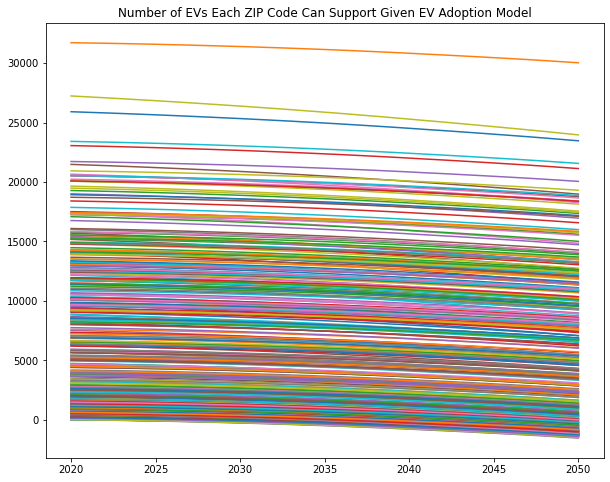

In [82]:
plt.figure(figsize=(10, 8))
plt.title('Number of EVs Each ZIP Code Can Support Given EV Adoption Model')
for zip_code, nums in energy_surplus_ev_zip_code.items():
  plt.plot(np.arange(2020, 2051), nums);

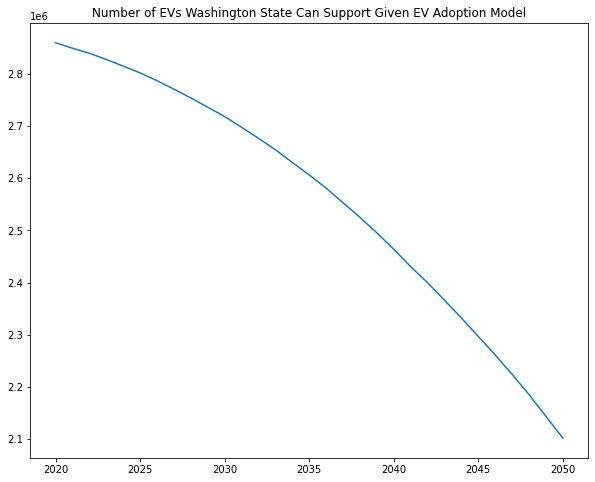

In [83]:
plt.figure(figsize=(10, 8))
plt.title('Number of EVs Washington State Can Support Given EV Adoption Model')
plt.plot(np.arange(2020, 2051), np.sum(np.array([arr for arr in energy_surplus_ev_zip_code.values()]), axis=0));

---

## Map of Electrical Capacity in Washington State

Given the models that we have created above, we will our findings using Python `folium`, a tool to display data on a geographic map.

In [0]:
import json
import folium
import branca
from folium.plugins import TimestampedGeoJson, MarkerCluster, TimeSliderChoropleth

### Establishing Process of Creating Folium Map

Below, we will establish a process for how to get data into a Folium map. First we need to create a dataframe with a Zip and Count column.

In [85]:
# Create copy of ev_reg
ev_reg_agg = ev_reg.copy()

# Clean zip code column
# ev_reg_agg = ev_reg_agg.dropna(subset=["Zip"])
# ev_reg_agg["Zip"] = ev_reg_agg["Zip"].astype(int).astype(str)

# Aggregate by zip code and then clean
ev_reg_agg = ev_reg_agg.groupby("Zip").count()[["Make"]]
ev_reg_agg = ev_reg_agg.rename(columns={"Make": "Count"})
ev_reg_agg.reset_index(level=0, inplace=True)

ev_reg_agg.sort_values("Count", ascending=False)

,Zip,Count
39,98052,8672
26,98033,5224
3,98004,5137
70,98115,4944
5,98006,4925
...,...,...
334,98628,2
96,98195,2
498,99220,2
226,98395,1


Then, we need to filter out our imported Washington state geojson for ZIP codes that actually exist within our dataframe.

In [86]:
# Open Washington State zipcodes
with open(global_path + local_path + "/wa_washington_zip_codes_geo.min.json", "r") as jsonFile:
  data = json.load(jsonFile)

# Create new list for zip codes that exist in EV registration data       
geozips = []
for i in range(len(data["features"])):
  if data["features"][i]["properties"]["ZCTA5CE10"] in list(ev_reg_agg["Zip"]):
    geo_zipcode = data["features"][i]

    # Adding times property for time slider, but unfortunately does not work
    # geo_zipcode["properties"]["times"] = ["2010", "2011", "2012", "2013", "2014", "2015", "2016", "2017", "2018", "2019", "2020"]
    geozips.append(geo_zipcode)

# Creating new JSON using geozips
new_json = dict.fromkeys(["type", "features"])
new_json["type"] = "FeatureCollection"
new_json["features"] = geozips

# Saving data
open(global_path + local_path + "/cleaned_washington_zip_codes_geo.json", "w").write(
    json.dumps(new_json, sort_keys=True, indent=4, separators=[",", ": "])
)

100900498

Finally, we need instantiate an instace of a Folium map, and then add a Folium chloropleth with the appropriate fields. We can then optionally save the map.

In [88]:
wa_coordinates = [47.7511, -120.7401]
wa_map = folium.Map(location=wa_coordinates, zoom_start=7)

folium.Choropleth(
    geo_data=global_path + local_path + "/cleaned_washington_zip_codes_geo.json",
    data=ev_reg_agg,
    columns=["Zip", "Count"],
    fill_color='RdYlGn',
    fill_opacity=0.7, 
    line_opacity=0.2,
    key_on="feature.properties.ZCTA5CE10",
    legend_name='EVs per ZIP Code'
).add_to(wa_map)

# TIME SLIDER ATTEMPTS

# TimeSliderChoropleth(
#     geozips,
#     styledict=styledict, overlay = True
# ).add_to(wa_map)

# TimestampedGeoJson(
#     {'type': 'FeatureCollection',
#     'features': geozips}
#     , period='P1Y'
#     , add_last_point=True
#     , auto_play=False
#     , loop=False
#     , max_speed=1
#     , loop_button=True
#     , date_options='YYYY/MM'
#     , time_slider_drag_update=True
# ).add_to(wa_map)

# wa_map.save(outfile=global_path + local_path + "/wa_map.html")
wa_map

#### Coordinates DataFrame

In order to make our Folium map a bit more interactive, we want to place markers at each coordinate of each ZIP code. To do this, we first need to construct a dataframe that maps each zip codes to the corresponding latitude and longitudes, as well as combining with what other data we have.

In [98]:
coords_df = pd.DataFrame()
zip_codes_col = []
latitudes_col = []
longitudes_col = []

# Parse through geojson data to get latitudes and longitudes
for i in range(len(data['features'])):
  props = data['features'][i]['properties']
  if props['ZCTA5CE10'] in list(ev_reg_agg['Zip']):
    zip_codes_col.append(props['ZCTA5CE10'])
    latitudes_col.append(float(props['INTPTLAT10'][1:]))
    longitudes_col.append(float(props['INTPTLON10']))

# Join in population df data from earlier
coords_df = pd.DataFrame(columns=['Zip', 'Lat', 'Lon'], data=np.transpose([zip_codes_col, latitudes_col, longitudes_col]))
coords_df = coords_df.merge(pop_df, left_on='Zip', right_on='Zip Code').drop(columns=['Zip Code'])
coords_df['Lat'] = coords_df['Lat'].astype(float)
coords_df['Lon'] = coords_df['Lon'].astype(float)
coords_df

,Zip,Lat,Lon,Rank,Population,Proportion of Population,Energy Surplus per ZIP Code,EVs Supported by Surplus
0,98822,47.901926,-120.550451,356,1909,0.000264,4615.371599,769.228600
1,98357,48.333855,-124.635404,370,1645,0.000228,3977.101247,662.850208
2,98663,45.657395,-122.663161,196,14318,0.001983,34616.495841,5769.415973
3,98684,45.630556,-122.514839,95,29433,0.004077,71159.891191,11859.981865
4,98848,47.168643,-119.842939,210,12541,0.001737,30320.259417,5053.376570
...,...,...,...,...,...,...,...,...
490,98506,47.108292,-122.870623,178,17372,0.002406,42000.123323,7000.020554
491,98264,48.950253,-122.459792,162,20780,0.002879,50239.613324,8373.268887
492,99171,47.098248,-117.653890,414,1068,0.000148,2582.093697,430.348950
493,98903,46.544080,-121.022416,197,14312,0.001983,34601.989696,5766.998283


To give our map a bit more information, we will also include the city and name of the county for each ZIP code.

In [99]:
us_zips_df = pd.read_csv(global_path + local_path + '/uszips.csv')
wa_zips_df = us_zips_df[us_zips_df['state_id'] == 'WA'][['zip', 'city', 'county_name']]
wa_zips_df['zip'] = wa_zips_df['zip'].astype(str)

coords_df = coords_df.merge(wa_zips_df, left_on='Zip', right_on='zip').drop(columns='zip').rename(columns={'city': 'City', 'county_name': 'County'})
coords_df

,Zip,Lat,Lon,Rank,Population,Proportion of Population,Energy Surplus per ZIP Code,EVs Supported by Surplus,City,County
0,98822,47.901926,-120.550451,356,1909,0.000264,4615.371599,769.228600,Entiat,Chelan
1,98357,48.333855,-124.635404,370,1645,0.000228,3977.101247,662.850208,Neah Bay,Clallam
2,98663,45.657395,-122.663161,196,14318,0.001983,34616.495841,5769.415973,Vancouver,Clark
3,98684,45.630556,-122.514839,95,29433,0.004077,71159.891191,11859.981865,Vancouver,Clark
4,98848,47.168643,-119.842939,210,12541,0.001737,30320.259417,5053.376570,Quincy,Grant
...,...,...,...,...,...,...,...,...,...,...
490,98506,47.108292,-122.870623,178,17372,0.002406,42000.123323,7000.020554,Olympia,Thurston
491,98264,48.950253,-122.459792,162,20780,0.002879,50239.613324,8373.268887,Lynden,Whatcom
492,99171,47.098248,-117.653890,414,1068,0.000148,2582.093697,430.348950,Saint John,Whitman
493,98903,46.544080,-121.022416,197,14312,0.001983,34601.989696,5766.998283,Yakima,Yakima


### Formalizing Folium Map Process

We can formalize the process executed above by creating some functions.

#### Create ZIP Code DataFrame

Gets the data for a particular year from the EV surplus supported dictionary, which maps ZIP code to number of EVs able to support over future years 2021 to 2050 given the average surplus.

In [0]:
def get_zip_code_data_by_year(data, year):
  count = [int(data[zip_code][year - 2021]) for zip_code in data.keys()]
  df = pd.DataFrame(data=np.transpose([list(data.keys()), count]), columns=['Zip', 'Count'])
  df['Count'] = df['Count'].astype(int)
  return df

#### Clean GEOJSON

Rewrites to the Washington state geojson to only list ZIP codes that are included within the ZIP code dataframe.

In [0]:
def clean_washington_zip_codes_geojson(df):
  # Open Washington State zipcodes
  with open(global_path + local_path + "/wa_washington_zip_codes_geo.min.json", "r") as jsonFile:
    data = json.load(jsonFile)

  # Create new list for zip codes that exist in EV registration data  
  geozips = []
  for i in range(len(data["features"])):
    geo_zipcode = data["features"][i]
    if geo_zipcode["properties"]["ZCTA5CE10"] in list(df["Zip"]):

      # Adding times property for time slider, but unfortunately does not work
      # geo_zipcode["properties"]["times"] = ["2010", "2011", "2012", "2013", "2014", "2015", "2016", "2017", "2018", "2019", "2020"]
      geozips.append(geo_zipcode)

  # Creating new JSON using geozips
  new_json = dict.fromkeys(["type", "features"])
  new_json["type"] = "FeatureCollection"
  new_json["features"] = geozips

  # Saving data
  open(global_path + local_path + "/cleaned_washington_zip_codes_geo.json", "w").write(
      json.dumps(new_json, sort_keys=True, indent=4, separators=[",", ": "])
  )

#### Create Map

Creates the Folium map given the geojson data and the ZIP code data, and also gives the option to save the map.

In [0]:
def create_map(df, colormap_data, save=False, save_file_name='', json_path='/cleaned_washington_zip_codes_geo.json'):
  washington_coords = [47.7511, -120.7401]
  folium_map = folium.Map(location=washington_coords, zoom_start=7)

  folium.Choropleth(
      geo_data=global_path + local_path + json_path,
      data=df,
      columns=['Zip', 'Count'],
      fill_color='RdYlGn',
      fill_opacity=0.7, 
      line_opacity=0.2,
      key_on='feature.properties.ZCTA5CE10',
      legend_name=colormap_data['caption'],
      bins=colormap_data['steps']
  ).add_to(folium_map)

  # Add a marker for every record in the filtered data, use a clustered view
  marker_cluster = MarkerCluster().add_to(folium_map) 

  for i in range(len(df)):
    zip_code = df['Zip'][i]
    city = df['City'][i]
    county = df['County'][i]
    count = df['Count'][i]
    lat, lon = df['Lat'][i], df['Lon'][i]

    location = [lat, lon]
    tooltip = "Zipcode: <b>{}</b> <br> City: <b>{}</b> <br> County: <b>{}</b> <br> Click for more".format(zip_code, city, county)
    
    folium.Marker(location,
                  popup="""
                  <i>Population: </i> <b>{}</b> <br> 
                  <i>Population Percentage: <b>{}%</b><br>
                  <i>Number EVs Supportable by Surplus: <b>{}</b><br>
                  <i>Number of EVs Sustainable: </i><b> {}</b><br>""".format(
                    df['Population'][i], 
                    round(df['Proportion of Population'][i] * 100, 4),
                    round(df['EVs Supported by Surplus'][i], 4),
                    count),
                  tooltip=tooltip).add_to(marker_cluster)


  # TIME SLIDER ATTEMPTS

  # TimeSliderChoropleth(
  #     geozips,
  #     styledict=styledict, overlay = True
  # ).add_to(wa_map)

  # TimestampedGeoJson(
  #     {'type': 'FeatureCollection',
  #     'features': geozips}
  #     , period='P1Y'
  #     , add_last_point=True
  #     , auto_play=False
  #     , loop=False
  #     , max_speed=1
  #     , loop_button=True
  #     , date_options='YYYY/MM'
  #     , time_slider_drag_update=True
  # ).add_to(wa_map)

  if save:
    folium_map.save(outfile=global_path + local_path + '/' + save_file_name)

  return folium_map

### Mapping Out EV Capacity in Each ZIP Code Over the Years

Finally, we will put these procedures to the test by mapping out the data that we gathered previously.

#### EV Capacity in 2021

In [129]:
evs_support_2021 = get_zip_code_data_by_year(energy_surplus_ev_zip_code, 2021)
clean_washington_zip_codes_geojson(evs_support_2021)
evs_support_2021 = evs_support_2021.merge(coords_df, on='Zip')
bins = list(evs_support_2021['Count'].quantile([0, 0.4, 0.6, 0.8, 1]))
colormap_data = {
    'scale': [0, 30000],
    'steps': bins,
    'caption': 'Number of EVs Able to Support in 2021'
}

create_map(evs_support_2021, colormap_data, True, 'evs_support_2021_markers.html')

Output hidden; open in https://colab.research.google.com to view.

#### EV Capacity in 2030

In [130]:
evs_support_2030 = get_zip_code_data_by_year(energy_surplus_ev_zip_code, 2030)
clean_washington_zip_codes_geojson(evs_support_2030)
evs_support_2030 = evs_support_2030.merge(coords_df, on='Zip')
bins = list(evs_support_2030['Count'].quantile([0, 0.4, 0.6, 0.8, 1]))
colormap_data = {
    'scale': [0, 30000],
    'steps': bins,
    'caption': 'Number of EVs Able to Support in 2030'
}

create_map(evs_support_2030, colormap_data, True, 'evs_support_2030_markers.html')

Output hidden; open in https://colab.research.google.com to view.

#### EV Capacity in 2050

In [131]:
# evs_support_2050 = get_zip_code_data_by_year(energy_surplus_ev_zip_code, 2050)
# clean_washington_zip_codes_geojson(evs_support_2050)
# create_map(evs_support_2050, 'Number of EVs Able to Support in 2050', True, 'evs_support_2050.html')

evs_support_2050 = get_zip_code_data_by_year(energy_surplus_ev_zip_code, 2050)
clean_washington_zip_codes_geojson(evs_support_2050)
evs_support_2050 = evs_support_2050.merge(coords_df, on='Zip')
bins = list(evs_support_2050['Count'].quantile([0, 0.4, 0.6, 0.8, 1]))
colormap_data = {
    'scale': [0, 30000],
    'steps': bins,
    'caption': 'Number of EVs Able to Support in 2050'
}

create_map(evs_support_2050, colormap_data, True, 'evs_support_2050_markers.html')